In [1]:
from pathlib import Path

import cv2
import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import supervision as sv
import torch
import torchvision

from groundingdino.util.inference import load_image, predict, annotate

from paths import *
from gd_sam import gd_model, bboxes_transform, apply_boxes, gd_sam_predict, filter_boxes
from plotting import add_image_and_mask

print("PyTorch version:", torch.__version__)
print("Torchvision version:", torchvision.__version__)
print("CUDA is available:", torch.cuda.is_available())

/users/yxu150/anaconda/cs2952n_new/lib/python3.9/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402374358/work/aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


final text_encoder_type: bert-base-uncased


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.predictions.transform.dense.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


PyTorch version: 2.0.0
Torchvision version: 0.15.0
CUDA is available: True


In [2]:
floe_library = loadmat(data_dir / "floe_masks.mat")["floe_lib"]

In [3]:
floe_shapes = np.array([
    mask[0].shape for mask in floe_library
])

max_height, max_width = np.percentile(floe_shapes, 99.5, axis=0)
print(max_height, max_width)

260.0 261.9500000000007


In [4]:
image_name = "Frobisher.Bay-20170423.terra.truecolor.250m.tiff"
image_path = truecolor_dir / image_name

image_source, image = load_image(image_path)

print("The shape of source image: ", image_source.shape)
print("The shape of pre-prcessed image: ", image.shape)

The shape of source image:  (1038, 1317, 3)
The shape of pre-prcessed image:  torch.Size([3, 800, 1015])


/users/yxu150/anaconda/cs2952n_new/lib/python3.9/site-packages/transformers/modeling_utils.py:862: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/users/yxu150/anaconda/cs2952n_new/lib/python3.9/site-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")
2023-05-10 09:54:26.072377: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1


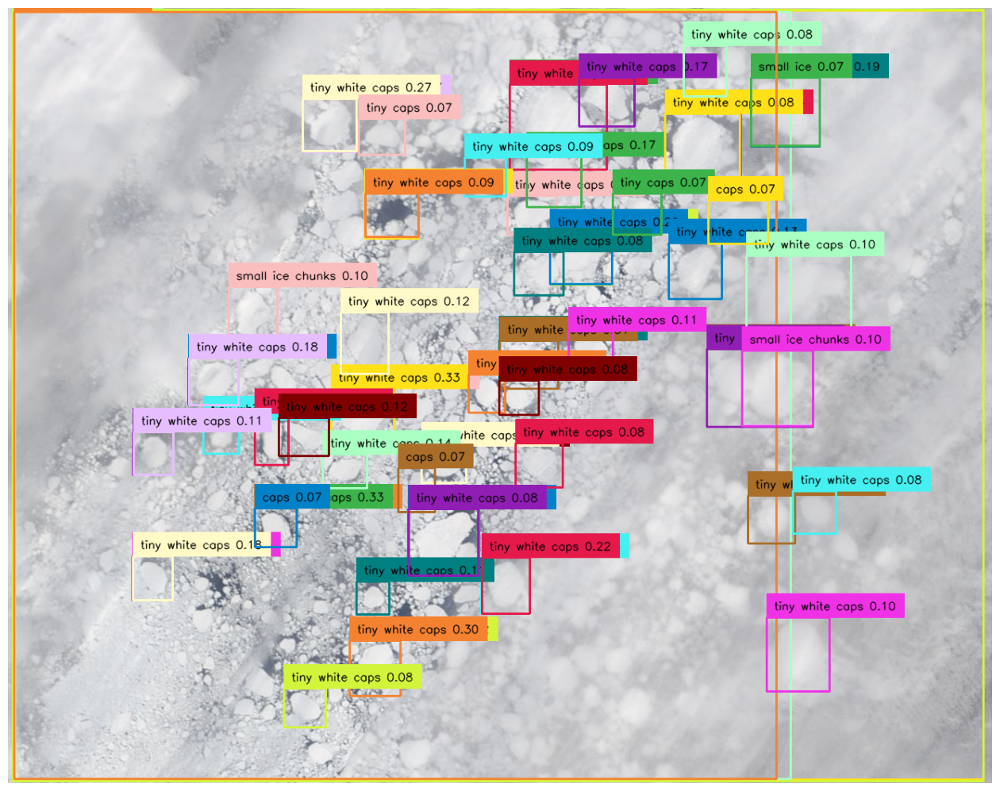

In [5]:
text_prompt = "small ice chunks , tiny white caps"
threshold = 0.07

boxes, logits, phrases = predict(
    model=gd_model, 
    image=image, 
    caption=text_prompt, 
    box_threshold=threshold, 
    text_threshold=threshold
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline  
sv.plot_image(annotated_frame, (16, 16))

In [6]:
boxes, logits, phrases = filter_boxes(
    boxes, logits, phrases, image_source
)

boxes

tensor([[0.7060, 0.1830, 0.0765, 0.0916],
        [0.5591, 0.1543, 0.0985, 0.1105],
        [0.4427, 0.6901, 0.0716, 0.0858],
        [0.2718, 0.6713, 0.0427, 0.0500],
        [0.7060, 0.1829, 0.0764, 0.0909],
        [0.5591, 0.1544, 0.0985, 0.1100],
        [0.4428, 0.6901, 0.0713, 0.0856],
        [0.3732, 0.8521, 0.0517, 0.0713],
        [0.3606, 0.5272, 0.0645, 0.0713],
        [0.5295, 0.4604, 0.0598, 0.0620],
        [0.3267, 0.1518, 0.0550, 0.0683],
        [0.5296, 0.4605, 0.0596, 0.0617],
        [0.3269, 0.1520, 0.0549, 0.0678],
        [0.4431, 0.5898, 0.0459, 0.0471],
        [0.5592, 0.1545, 0.0987, 0.1099],
        [0.2720, 0.6713, 0.0424, 0.0499],
        [0.3604, 0.5273, 0.0642, 0.0708],
        [0.2089, 0.4826, 0.0505, 0.0613],
        [0.3734, 0.8519, 0.0514, 0.0709],
        [0.6084, 0.1223, 0.0565, 0.0626],
        [0.5058, 0.7457, 0.0490, 0.0720],
        [0.1470, 0.7359, 0.0408, 0.0566],
        [0.5822, 0.3244, 0.0631, 0.0664],
        [0.5325, 0.2684, 0.0504, 0

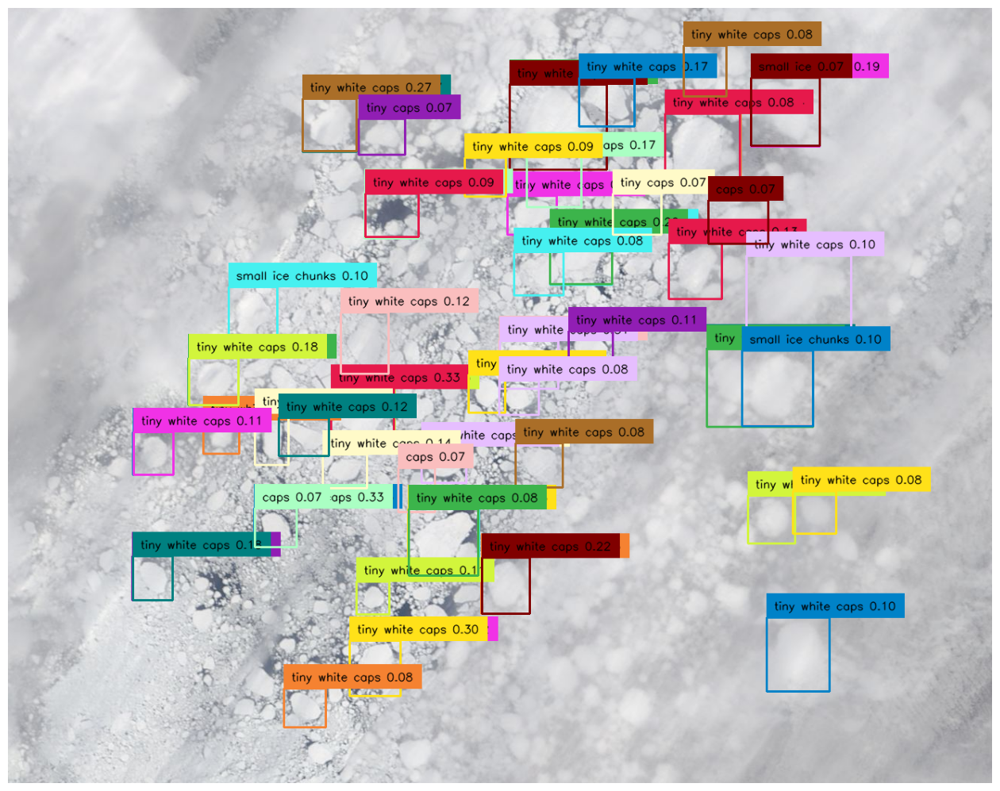

In [7]:
annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

sv.plot_image(annotated_frame, (16, 16))

In [8]:
mask, scores = apply_boxes(boxes, image_source)

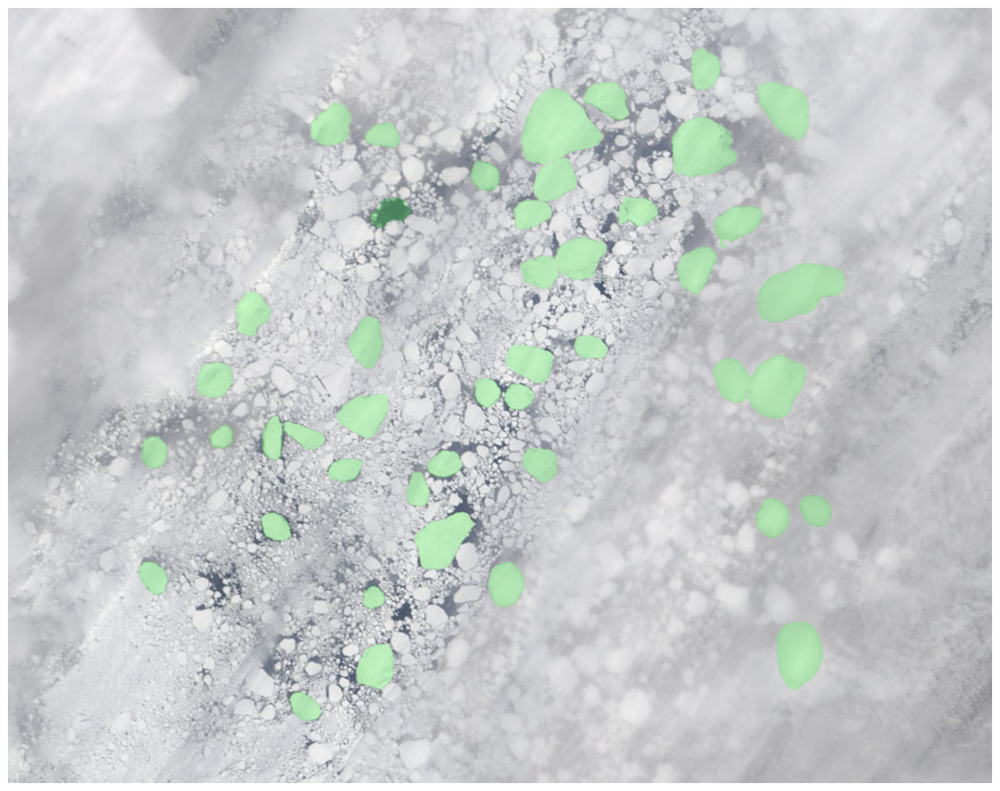

In [9]:
plt.figure(figsize=(16, 16))
add_image_and_mask(image_source, mask.any(axis=0).cpu(), plt.gca())
plt.show()

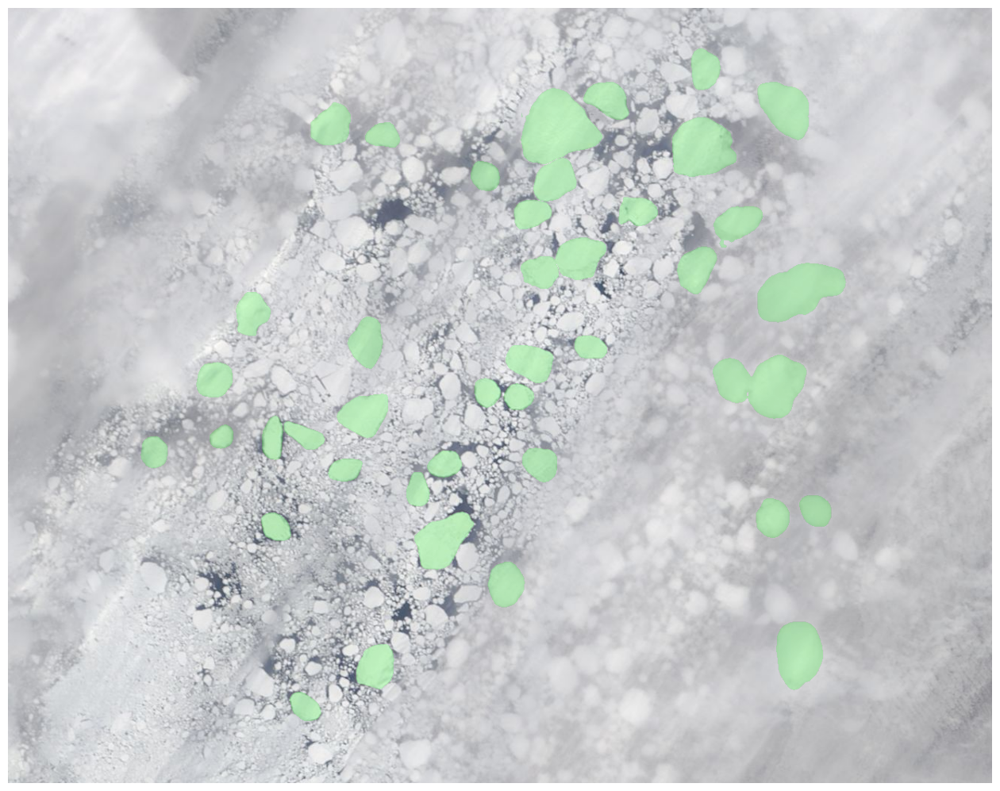

In [10]:
plt.figure(figsize=(16, 16))
add_image_and_mask(image_source, mask[scores >= 0.9].any(axis=0).cpu(), plt.gca())
plt.show()

In [11]:
sam_image, gd_image = load_image(image_path)
masks = gd_sam_predict(gd_image, sam_image)

/users/yxu150/anaconda/cs2952n_new/lib/python3.9/site-packages/transformers/modeling_utils.py:862: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/users/yxu150/anaconda/cs2952n_new/lib/python3.9/site-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


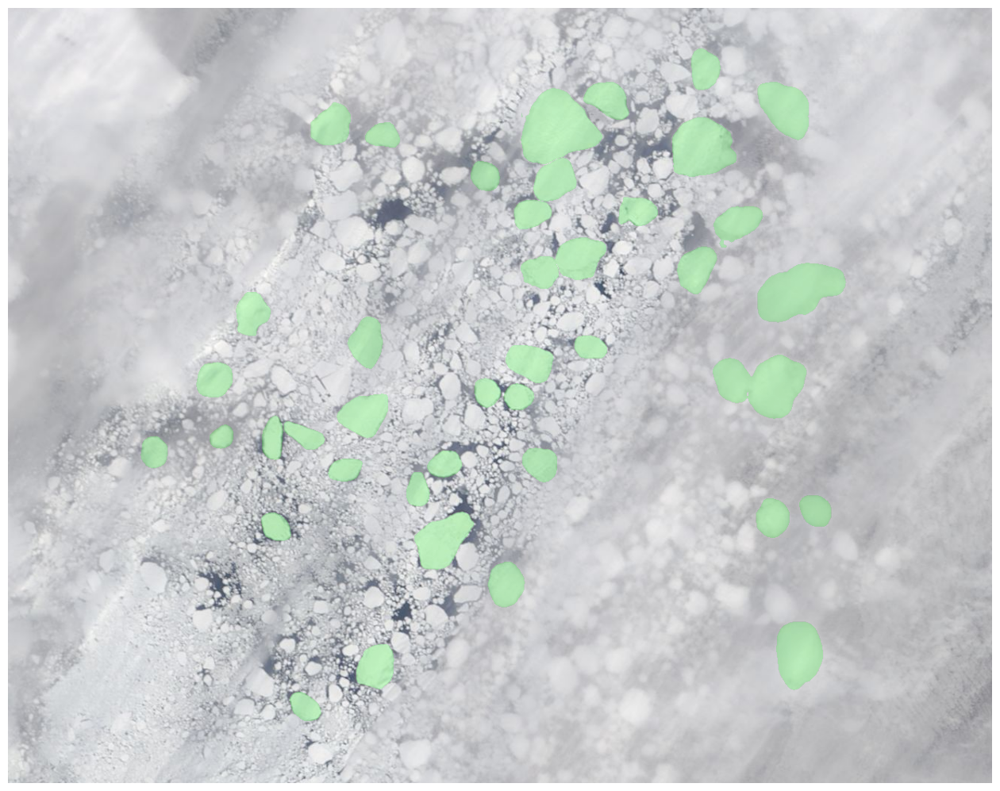

In [12]:
plt.figure(figsize=(16, 16))
add_image_and_mask(sam_image, masks.any(axis=0), plt.gca())
plt.show()

In [13]:
all_image_paths = list(truecolor_dir.glob("*.tiff"))

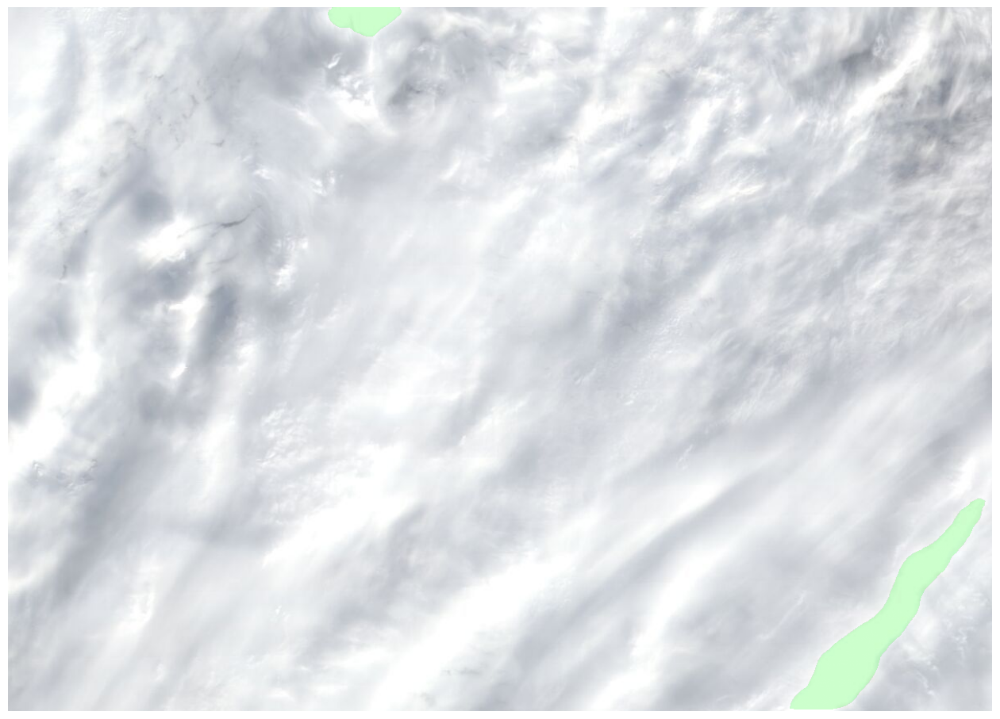

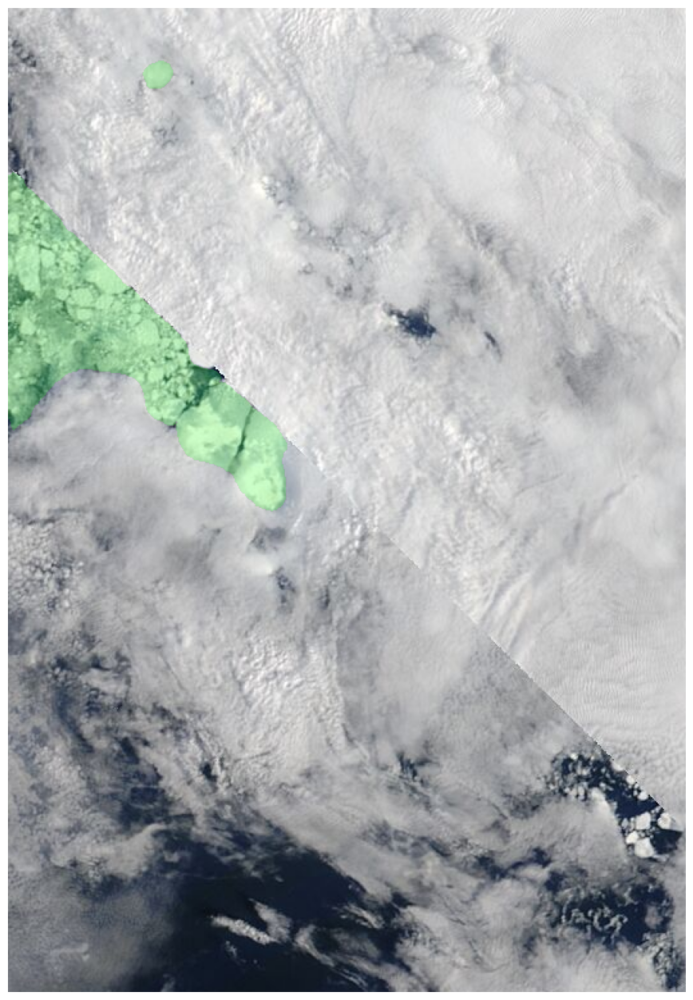

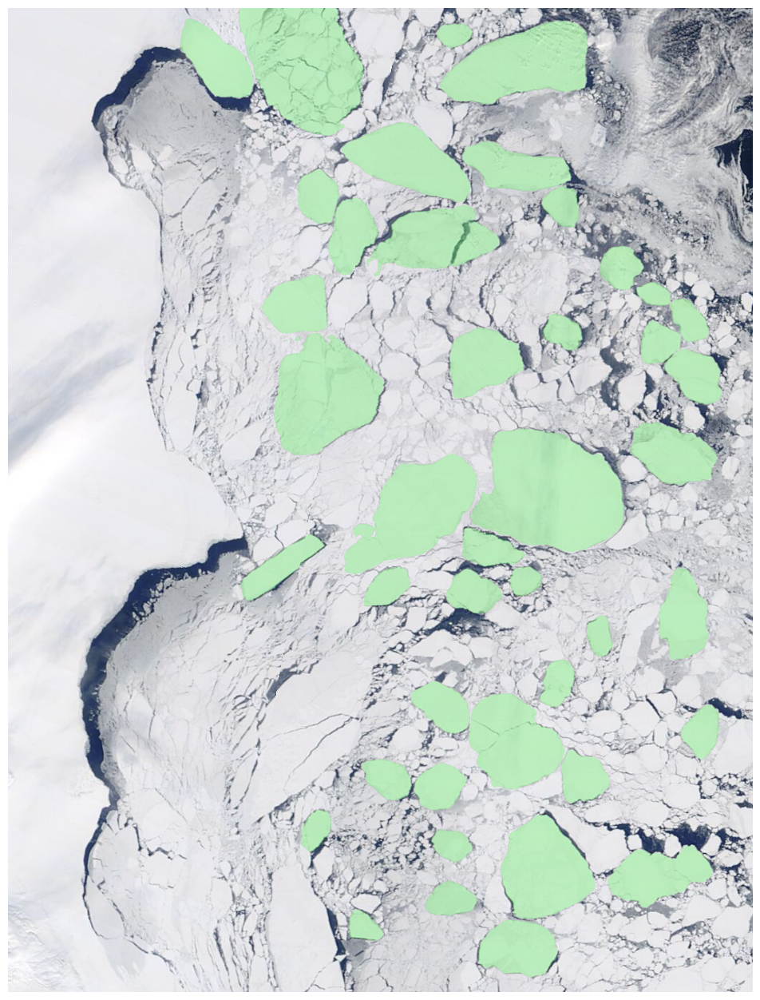

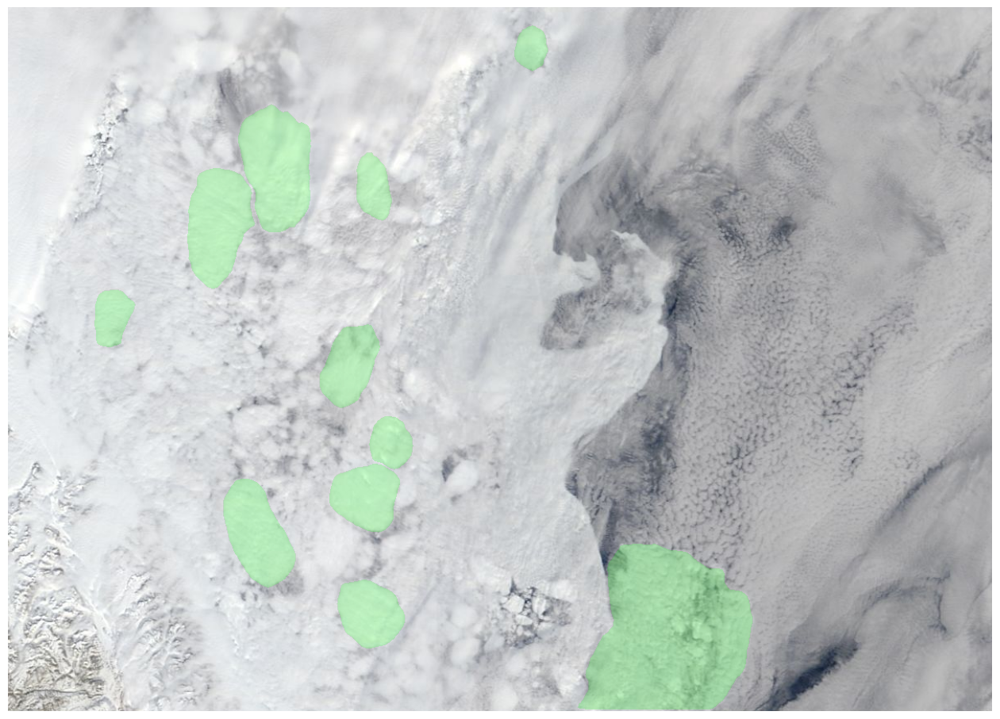

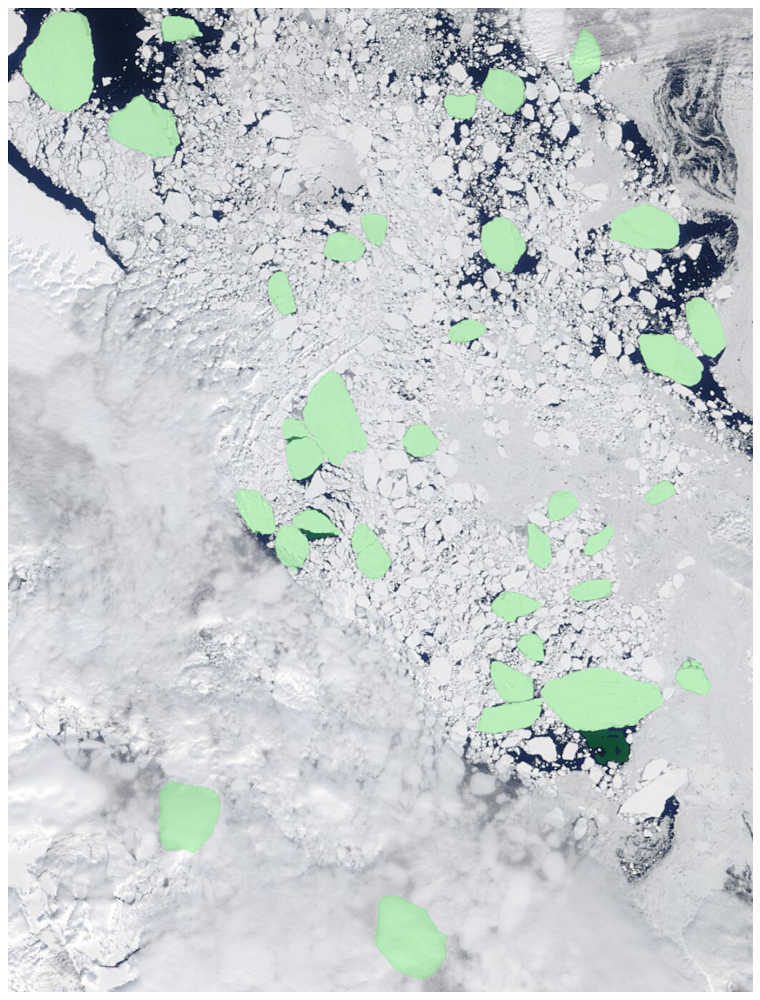

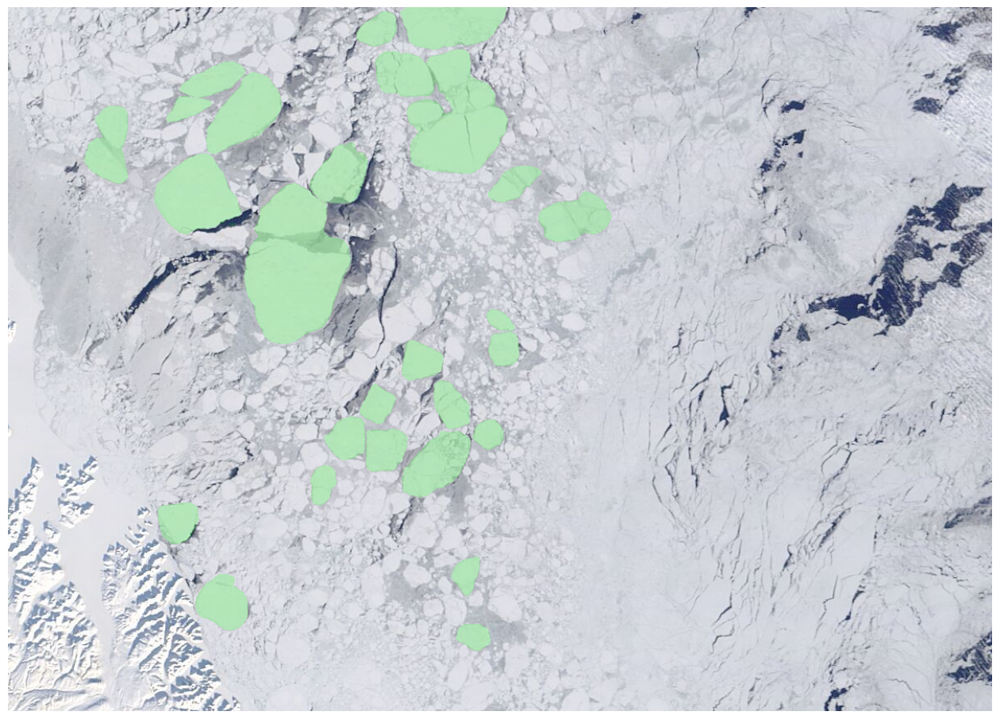

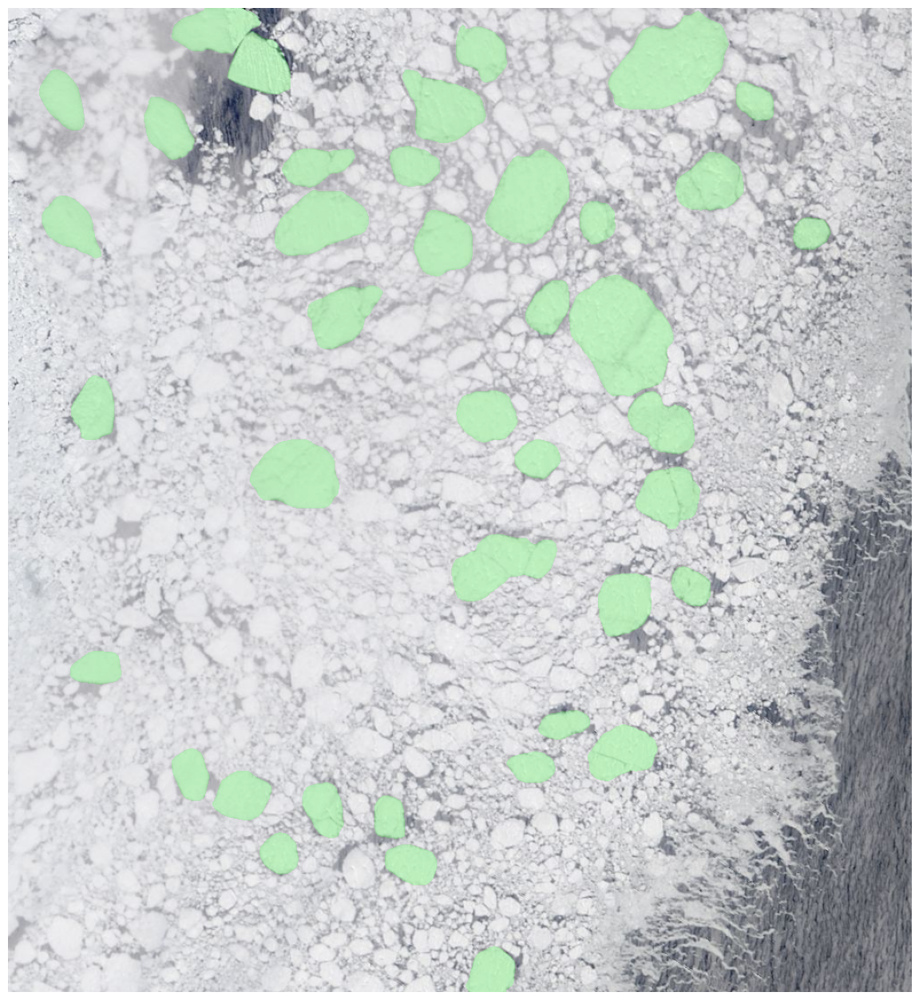

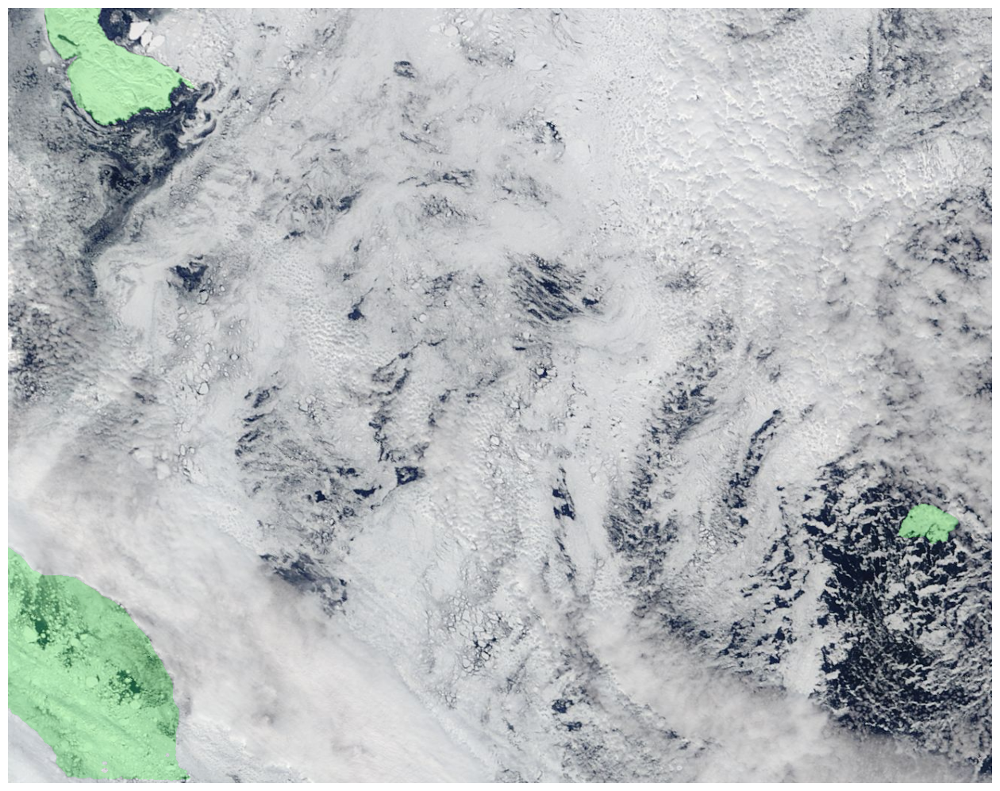

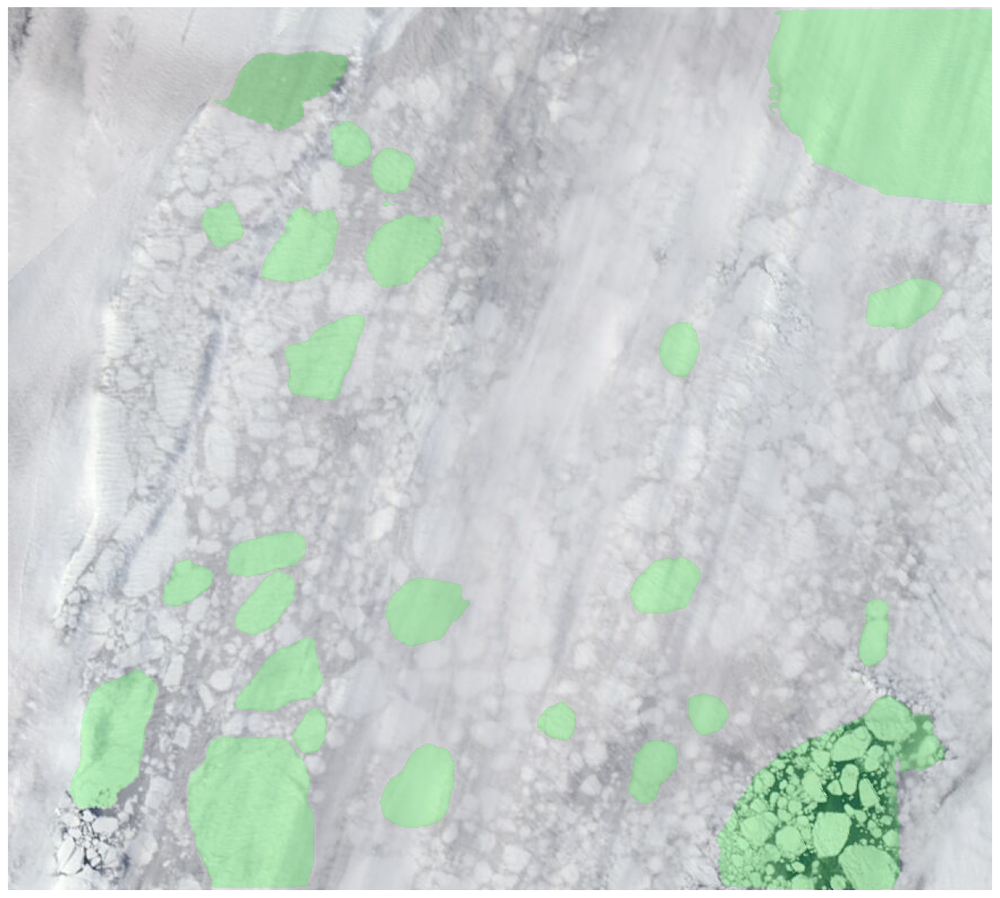

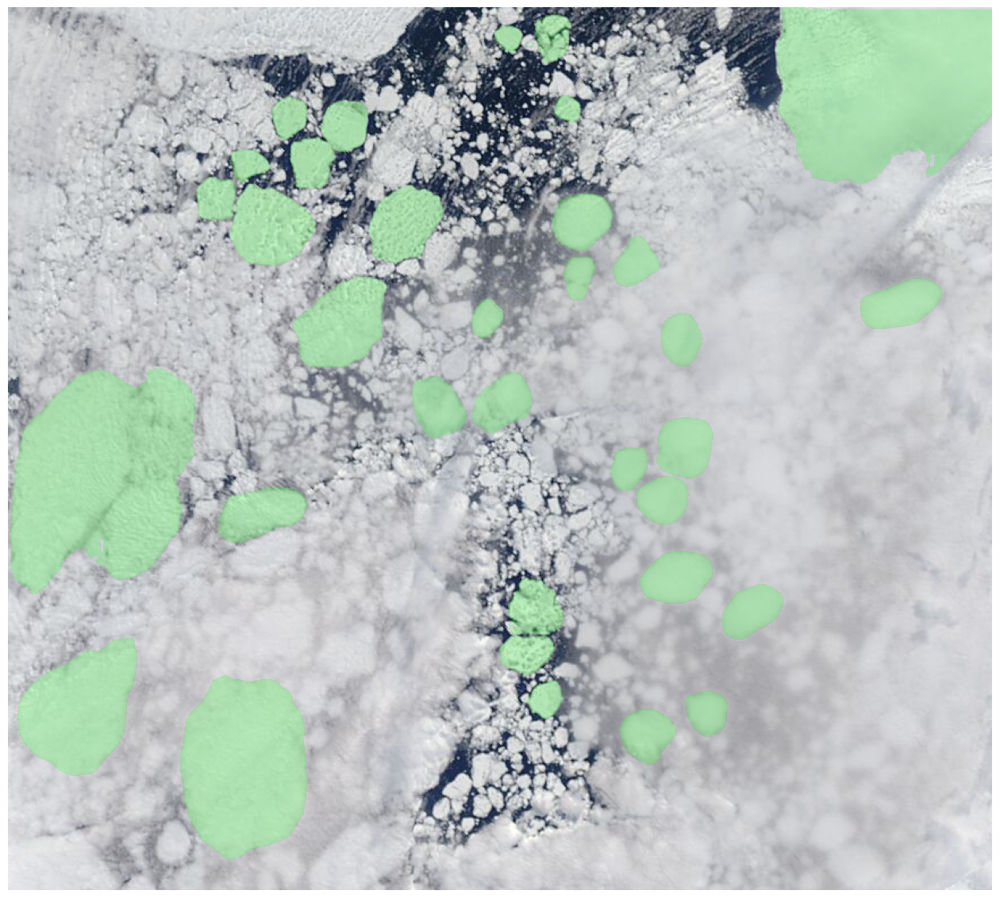

In [14]:
for i in np.random.randint(len(all_image_paths), size=10):
    
    sam_image, gd_image = load_image(all_image_paths[i])
    
    masks = gd_sam_predict(
        gd_image,
        sam_image,
        text_prompt="small ice chunks , tiny white caps , large ice floes",
        score_threshold=0.92,
        box_threshold=0.07,
        brightness_threshold=0.7
    )
    
    if masks is None:
        print("No masks detected.")
        continue
    
    plt.figure(figsize=(16, 16))
    add_image_and_mask(sam_image, masks.any(axis=0), plt.gca())
    plt.show()